In [1]:
pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.9/80.9 kB 2.5 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [172]:
import sys
from pathlib import Path
import numpy as np
import torch
import cv2
from torchvision import models
from torchvision.ops import nms
from torchvision.transforms import functional as F
import torchvision.transforms as transforms
from sklearn.svm import SVC
from sklearn.metrics import classification_report
from torch.utils.data import DataLoader, TensorDataset
from sklearn.utils import shuffle
from torchvision.ops import nms
import joblib
from tqdm import tqdm
import matplotlib.pyplot as plt
import gc
import os


project_dir = Path('/kaggle/input/pedestrian-tracking-full/team_49_pedestrian_tracking')
src_dir = project_dir / 'src'

sys.path.append(str(src_dir))

from data_loader import *
from visualization import *

In [3]:
api_key = "iOJNkzHKPzOLoZ0dIkM9"
workspace = "aerial-person-detection"
project_name = "aerial-person-detection"
version_num = 3

dataset_dir = download_dataset(api_key, workspace, project_name, version_num, "./data")
# dataset_dir = Path('/kaggle/working/data/Aerial-Person-Detection-3')

train_images_dir = dataset_dir / 'train/images'
train_labels_dir = dataset_dir / 'train/labels'
valid_images_dir = dataset_dir / 'valid/images'
valid_labels_dir = dataset_dir / 'valid/labels'

data_yaml_path = dataset_dir / 'data.yaml'
class_names = load_classes(data_yaml_path)

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Aerial-Person-Detection-3 in yolov11:: 100%|██████████| 13989/13989 [00:04<00:00, 3405.23it/s]


Датасет успешно перемещён в data/Aerial-Person-Detection-3


In [4]:
def get_average_bbox_size(images, labels_dir, class_name, class_names):
    total_width, total_height, count = 0, 0, 0
    person_class_id = class_names.index(class_name)

    for image_name in images:
        bboxes = load_bounding_boxes(image_name, labels_dir)
        for class_id, x_center, y_center, box_width, box_height in bboxes:
            if class_id == person_class_id:
                total_width += box_width
                total_height += box_height
                count += 1

    if count == 0:
        raise ValueError(f'Bboxes отсутствуют для класса {class_name}')
    
    avg_width = total_width / count
    avg_height = total_height / count
    return avg_width, avg_height

In [5]:
def visualize_patches(patches, num_samples=5, title="Визуализация патчей"):
    num_samples = min(num_samples, len(patches))

    plt.figure(figsize=(15, 5))
    for i in range(num_samples):
        plt.subplot(1, num_samples, i + 1)
        plt.imshow(patches[i])
        plt.axis("off")
    plt.suptitle(title, fontsize=16)
    plt.show()

In [6]:
def get_image_names(images_dir):
    return [file.stem for file in images_dir.glob('*.jpg')]

In [7]:
train_images = get_image_names(train_images_dir)
valid_images = get_image_names(valid_images_dir)

In [9]:
class_names

['bicycle', 'bus', 'car', 'motorcycle', 'person', 'truck']

## Image Processing

In [10]:
avg_width, avg_height = get_average_bbox_size(train_images, train_labels_dir, 'person', class_names)
print(f'{avg_width}, {avg_height}')

0.010823901758710713, 0.03027124658605152


In [12]:
def extract_persons(images, labels_dir, avg_width, avg_height, class_name, class_names):
    person_class_id = class_names.index(class_name)
    persons = []

    for image_name in tqdm(images):
        image_path = train_images_dir / f"{image_name}.jpg"
        image = cv2.imread(str(image_path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape

        bboxes = load_bounding_boxes(image_name, labels_dir)
        for class_id, x_center, y_center, box_width, box_height in bboxes:
            if class_id == person_class_id:
                x_min = int((x_center - avg_width / 2) * w)
                y_min = int((y_center - avg_height / 2) * h)
                x_max = int((x_center + avg_width / 2) * w)
                y_max = int((y_center + avg_height / 2) * h)

                x_min, y_min = max(0, x_min), max(0, y_min)
                x_max, y_max = min(w, x_max), min(h, y_max)

                patch = image[y_min:y_max, x_min:x_max]
                persons.append(patch)
    
    return persons

In [ ]:
# persons_cut = extract_persons(train_images, train_labels_dir, avg_width, avg_height, 'person', class_names)
# np.save("persons_cut.npy", np.array(persons_cut, dtype=object))

In [218]:
patches_path = Path('/kaggle/input/pedestrian-patches')

In [219]:
persons_cut = np.load(patches_path / 'persons_cut.npy', allow_pickle=True)

Патчей с людьми: 105948


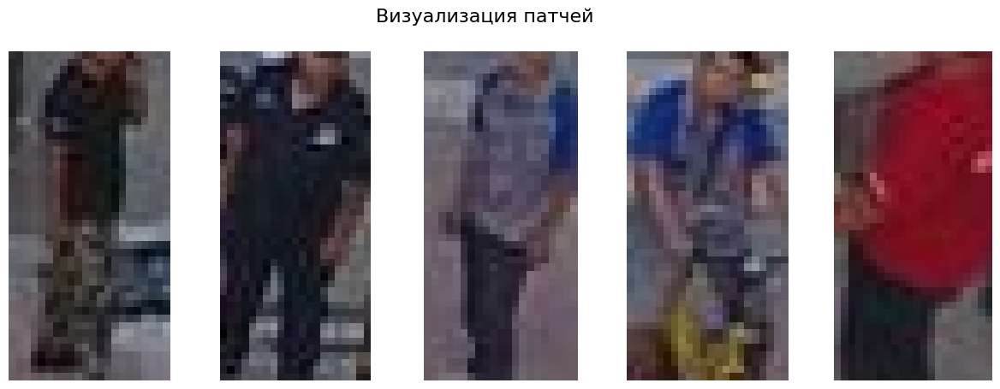

In [220]:
print(f'Патчей с людьми: {len(persons_cut)}')
visualize_patches(persons_cut, num_samples=5)

In [ ]:
import random

# Среднее число людей на фото — 17, сделаем число патчей для background в ~5 раз меньше
def extract_background(images, labels_dir, avg_width, avg_height, class_name, class_names, max_patches_per_image=3):
    background_patches = []
    person_class_id = class_names.index(class_name)

    for image_name in tqdm(images):
        image_path = train_images_dir / f"{image_name}.jpg"
        image = cv2.imread(str(image_path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        h, w, _ = image.shape

        # Загружаем bboxes
        bboxes = load_bounding_boxes(image_name, labels_dir)
        person_boxes = [
            (int((x_center - box_width / 2) * w), 
             int((y_center - box_height / 2) * h), 
             int((x_center + box_width / 2) * w), 
             int((y_center + box_height / 2) * h))
            for class_id, x_center, y_center, box_width, box_height in bboxes
            if class_id == person_class_id
        ]

        patches_found = 0
        attempts = 0

        while patches_found < max_patches_per_image and attempts < 3:
            x_min = random.randint(0, w - int(avg_width * w))
            y_min = random.randint(0, h - int(avg_height * h))
            x_max = x_min + int(avg_width * w)
            y_max = y_min + int(avg_height * h)

            no_overlap = all(
                x_max <= px_min or x_min >= px_max or
                y_max <= py_min or y_min >= py_max
                for px_min, py_min, px_max, py_max in person_boxes
            )

            if no_overlap:
                patch = image[y_min:y_max, x_min:x_max]
                background_patches.append(patch)
                patches_found += 1

            attempts += 1
    
    return background_patches

In [ ]:
# background_cut = extract_background(
#     train_images, train_labels_dir, avg_width, avg_height, "person", class_names, max_patches_per_image=3
# )
# np.save("background_cut.npy", np.array(background_cut, dtype=object))

In [221]:
background_cut = np.load(patches_path / 'background_cut.npy', allow_pickle=True)

Патчей с фоном: 19001


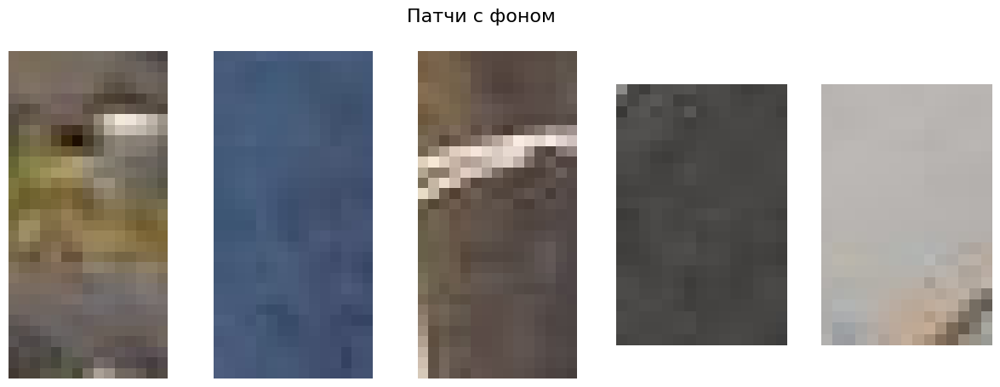

In [222]:
print(f'Патчей с фоном: {len(background_cut)}')
visualize_patches(background_cut, num_samples=5, title="Патчи с фоном")

In [223]:
heights_background, widths_background = zip(*[(patch.shape[0], patch.shape[1]) for patch in background_cut])

avg_heights_background = np.array(heights_background).mean()
avg_widths_background = np.array(widths_background).mean()

print(f'Средние размеры патчей для фона: высота {avg_heights_background}, ширина {avg_widths_background}')

Средние размеры патчей для фона: высота 29.720435766538603, ширина 16.090311036261248


In [224]:
heights_persons, widths_persons = zip(*[(patch.shape[0], patch.shape[1]) for patch in persons_cut])

avg_heights_persons = np.array(heights_persons).mean()
avg_widths_persons = np.array(widths_persons).mean()

print(f'Средние размеры патчей для людей: высота {avg_heights_persons}, ширина {avg_widths_persons}')

Средние размеры патчей для людей: высота 29.90134783101144, ширина 16.48349190168762


In [10]:
def resize_with_padding(image, target_size=(224, 224)): # Для весов Resnet
    h, w, c = image.shape
    target_width, target_height = target_size
    
    scale = min(target_width / w, target_height / h)
    new_w, new_h = int(w * scale), int(h * scale)
    
    resized_image = cv2.resize(image, (new_w, new_h), interpolation=cv2.INTER_AREA)
    
    padded_image = np.zeros((target_height, target_width, c), dtype=np.uint8)

    top = (target_height - new_h) // 2
    left = (target_width - new_w) // 2
    
    padded_image[top:top+new_h, left:left+new_w, :] = resized_image
    
    return padded_image


def process_patches(patches, target_size=(224, 224)):
    patches_resized = np.array([resize_with_padding(patch, target_size) for patch in tqdm(patches)])
    return patches_resized

In [ ]:
# batch_size = 10000
# total_batches = len(persons_cut) // batch_size + (len(persons_cut) % batch_size != 0)
# 
# for i in range(total_batches):
#     start = i * batch_size
#     end = start + batch_size
#     
#     batch = persons_cut[start:end]
#     resized_batch = process_patches(batch, target_size=(224, 224))
#     np.save(f"resized_person_patches_{i}.npy", np.array(resized_batch, dtype=np.uint8))
# 
# print(f"Ресайз завершен")

In [ ]:
# batch_size = 10000
# total_batches = len(background_cut) // batch_size + (len(background_cut) % batch_size != 0)
# 
# for i in range(total_batches):
#     start = i * batch_size
#     end = start + batch_size
#     
#     batch = background_cut[start:end]
#     resized_batch = process_patches(batch, target_size=(224, 224))
#     np.save(f"resized_background_patches_{i}.npy", np.array(resized_batch, dtype=np.uint8))
# 
# print(f"Ресайз завершен")

In [225]:
person_files = [f"resized_person_patches_{i}.npy" for i in range(1)]
background_files = [f"resized_background_patches_{i}.npy" for i in range(1)]

In [226]:
resize_path_persons = Path('/kaggle/input/resized-patches-types/resized_person/resized_person')
resize_path_background = Path('/kaggle/input/resized-patches-types/resized_background/resized_background')

In [227]:
def load_patches(file_paths, files):
    all_patches = []
    for file in files:
        print(f"Загрузка {file}")
        file_path = file_paths / file
        patches = np.load(file_path, allow_pickle=True)
        all_patches.extend(patches)
    return np.array(all_patches, dtype=np.uint8)

In [229]:
person_patches_resized = load_patches(resize_path_persons, person_files)

Загрузка resized_person_patches_0.npy


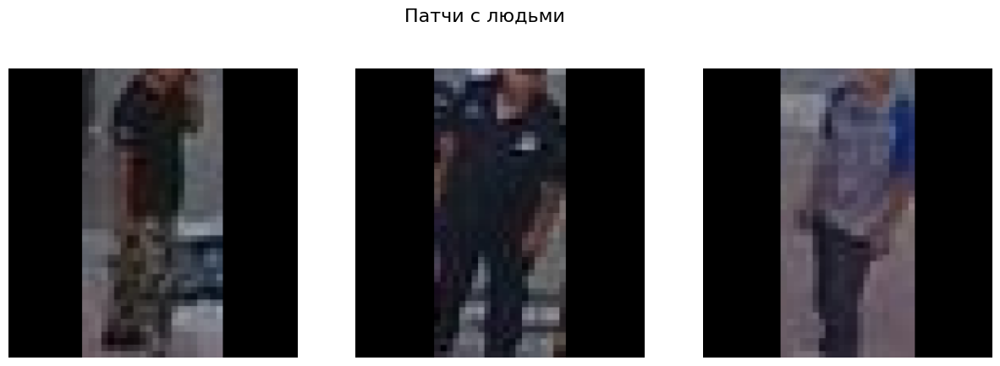

In [230]:
visualize_patches(person_patches_resized, num_samples=3, title="Патчи с людьми")

In [231]:
background_patches_resized = load_patches(resize_path_background, background_files)

Загрузка resized_background_patches_0.npy


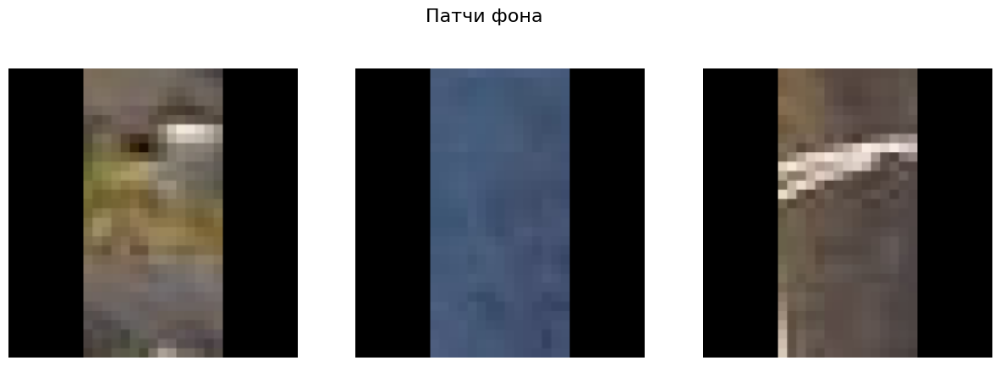

In [232]:
visualize_patches(background_patches_resized, num_samples=3, title="Патчи фона")

In [ ]:
person_files = [resize_path_persons / f"resized_person_patches_{i}.npy" for i in range(11)]
background_files = [resize_path_background / f"resized_background_patches_{i}.npy" for i in range(2)]

In [ ]:
def create_dataloader_from_files(file_paths, label, batch_size=512):
    for path in file_paths:
        print(f"Загрузка {path}")
        patches = np.load(path, allow_pickle=True)
        labels = np.full(len(patches), label)

        tensor_X = torch.tensor(patches).permute(0, 3, 1, 2).float() / 255.0
        tensor_y = torch.tensor(labels).long()

        dataset = TensorDataset(tensor_X, tensor_y)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
        yield dataloader

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Доступное устройство: {device}")

# Загрузка предобученной модели
resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2)
resnet = resnet.to(device)
resnet.eval()

In [ ]:
def extract_resnet_features_from_files(resnet, dataloaders, device):
    resnet.eval()
    all_features = []
    all_labels = []

    with torch.no_grad():
        for dataloader in dataloaders:
            for images, labels in tqdm(dataloader, desc="Извлечение признаков"):
                images = images.to(device)
                
                features = resnet(images)
                
                all_features.extend(features.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

    return np.array(all_features), np.array(all_labels)

In [ ]:
person_dataloader = create_dataloader_from_files(person_files, label=1, batch_size=512)

In [ ]:
X_person_features, y_person_labels = extract_resnet_features_from_files(resnet, person_dataloader, device)

In [ ]:
np.save("resnet_person_features.npy", X_person_features)
np.save("resnet_person_labels.npy", y_person_labels)
print("Извлечение признаков для патчей с людьми завершено.")

In [ ]:
background_dataloader = create_dataloader_from_files(background_files, label=0, batch_size=512)

In [ ]:
X_background_features, y_background_labels = extract_resnet_features_from_files(resnet, background_dataloader, device)

In [ ]:
np.save("resnet_background_features.npy", X_background_features)
np.save("resnet_background_labels.npy", y_background_labels)
print("Извлечение признаков для патчей с фоном завершено.")

## Model Train

In [233]:
X_person = np.load("/kaggle/input/resnet-features/resnet_person/resnet_person/resnet_person_features.npy")
y_person = np.load("/kaggle/input/resnet-features/resnet_person/resnet_person/resnet_person_labels.npy")

X_background = np.load("/kaggle/input/resnet-features/resnet_background/resnet_background/resnet_background_features.npy")
y_background = np.load("/kaggle/input/resnet-features/resnet_background/resnet_background/resnet_background_labels.npy")

print(f"Размеры данных: \nЦелевой класс: {X_person.shape}, Метки: {y_person.shape}")
print(f"Фон: {X_background.shape}, Метки: {y_background.shape}")

Размеры данных: 
Целевой класс: (105948, 1000), Метки: (105948,)
Фон: (19001, 1000), Метки: (19001,)


In [234]:
from sklearn.utils import shuffle

X = np.vstack((X_person, X_background))
y = np.hstack((y_person, y_background))

X, y = shuffle(X, y, random_state=42)

print(f"Данные объединены и перемешаны. Размер X: {X.shape}, Размер y: {y.shape}")

Данные объединены и перемешаны. Размер X: (124949, 1000), Размер y: (124949,)


In [235]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Обучающая выборка: {X_train.shape}, {y_train.shape}")
print(f"Тестовая выборка: {X_test.shape}, {y_test.shape}")

Обучающая выборка: (99959, 1000), (99959,)
Тестовая выборка: (24990, 1000), (24990,)


In [ ]:
from sklearn.svm import SVC

svm = SVC(kernel="linear", C=1.0, probability=True)
svm.fit(X_train[:30000], y_train[:30000])

print("Обучение SVM завершено.")

In [236]:
svm = joblib.load("/kaggle/input/svm-pedastrians/svm_trained_model (1).pkl")
print("Модель загружена")

Модель загружена


Базовая проверка качества для классификатора, прежде чем идти эксперименировать с изображениями

(с ограничением для демонстрации в выводе ноутбука)

In [238]:
from sklearn.metrics import classification_report, confusion_matrix

y_pred = svm.predict(X_test[:5000])

print("Оценка модели:")
print(classification_report(y_test[:5000], y_pred))

print("Матрица ошибок:")
print(confusion_matrix(y_test[:5000], y_pred))

Оценка модели:
              precision    recall  f1-score   support

           0       0.81      0.67      0.73       732
           1       0.94      0.97      0.96      4268

    accuracy                           0.93      5000
   macro avg       0.88      0.82      0.85      5000
weighted avg       0.93      0.93      0.93      5000

Матрица ошибок:
[[ 489  243]
 [ 114 4154]]


In [ ]:
import joblib

joblib.dump(svm, "svm_trained_model.pkl")
print("Модель SVM сохранена.")

## Prediction

### KMeans
Реализация с выбором регионов интереса при помощи кластеризации

In [12]:
import joblib
from sklearn.cluster import KMeans

def cluster_image(image, n_clusters=5):
    h, w, c = image.shape
    pixels = image.reshape((-1, c))
    
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init="auto")
    kmeans.fit(pixels)
    
    clustered_image = kmeans.labels_.reshape(h, w)
    return clustered_image, kmeans


def gaussian_blur(image, kernel_size=(15, 15), sigma=0):
    return cv2.GaussianBlur(image, kernel_size, sigma)
    

def get_kmeans_regions(image, clustered_image, min_size=380, max_size=3200, min_aspect_ratio=0.2, max_aspect_ratio=1, crop_ratio=0.1):
    regions = []
    img_h, img_w = image.shape[:2]

    center_x_min = int(img_w * crop_ratio)
    center_y_min = int(img_h * crop_ratio)
    center_x_max = int(img_w * (1 - crop_ratio))
    center_y_max = int(img_h * (1 - crop_ratio))

    for label in np.unique(clustered_image):
        mask = (clustered_image == label).astype(np.uint8)
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        for contour in contours:
            x, y, w, h = cv2.boundingRect(contour)
            x = max(0, x)
            y = max(0, y)
            w = min(w, img_w - x) 
            h = min(h, img_h - y)

            if not (center_x_min <= x <= center_x_max and 
                    center_y_min <= y <= center_y_max and 
                    center_x_min <= x + w <= center_x_max and 
                    center_y_min <= y + h <= center_y_max):
                continue
            
            area = w * h
            aspect_ratio = w / h if h > 0 else 0
            
            if (min_size <= area <= max_size and
                min_aspect_ratio <= aspect_ratio <= max_aspect_ratio):
                region = image[y:y+h, x:x+w]
                regions.append((region, (x, y, w, h)))

    return regions

def save_regions_to_file(image_name, regions, output_dir):
    output_file = output_dir / f"{image_name}_regions.pkl"
    joblib.dump(regions, output_file)

In [13]:
output_dir = Path("output_regions")
output_dir.mkdir(exist_ok=True, parents=True)

for image_name in tqdm(valid_images):
    image_file = valid_images_dir / f"{image_name}.jpg"
    image = cv2.imread(str(image_file))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    blurred = gaussian_blur(image)
    
    clustered_image, _ = cluster_image(blurred, n_clusters=5)
    
    regions = get_kmeans_regions(blurred, clustered_image)
    
    save_regions_to_file(image_name, regions, output_dir)

print("Регионы сохранены")

100%|██████████| 545/545 [05:54<00:00,  1.54it/s]

Регионы сохранены


In [14]:
import shutil

shutil.make_archive('/kaggle/working/output_backup', 'zip', '/kaggle/working/output_regions')
print("Папка заархивирована.")

Папка заархивирована.


In [13]:
# folder_path = "/kaggle/working/output_regions"

# if os.path.exists(folder_path):
#     # Удаляем все содержимое
#     shutil.rmtree(folder_path)
#     print(f"Папка {folder_path} очищена.")

In [11]:
def load_regions_from_file(file_path):
    return joblib.load(file_path)

def visualize_regions(image_path, regions, num_regions=5):
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    fig, ax = plt.subplots(1, figsize=(12, 8))
    ax.imshow(image)
    ax.set_title(f"Визуализация {num_regions} регионов интереса")
    
    for i, (_, (x, y, w, h)) in enumerate(regions[:num_regions]):
        rect = plt.Rectangle((x, y), w, h, edgecolor='r', facecolor='none', linewidth=2)
        ax.add_patch(rect)
        ax.text(x, y - 5, f"Region {i+1}", color='red', fontsize=10, va='bottom', ha='left')

    plt.axis("off")
    plt.show()

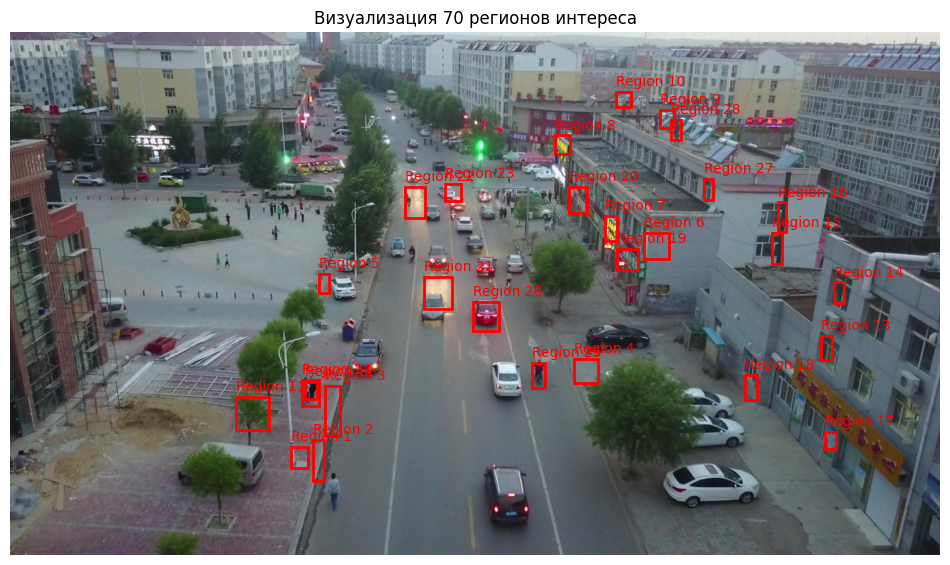

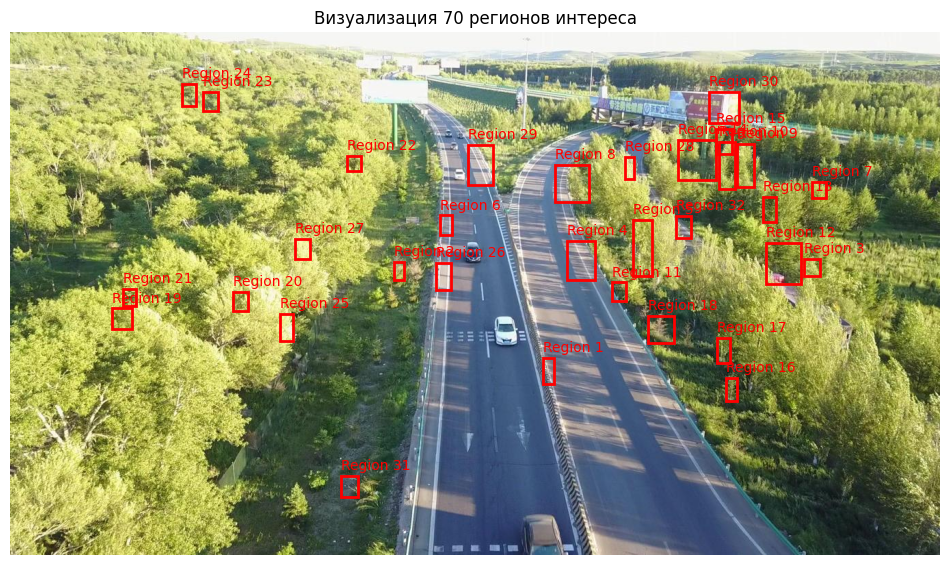

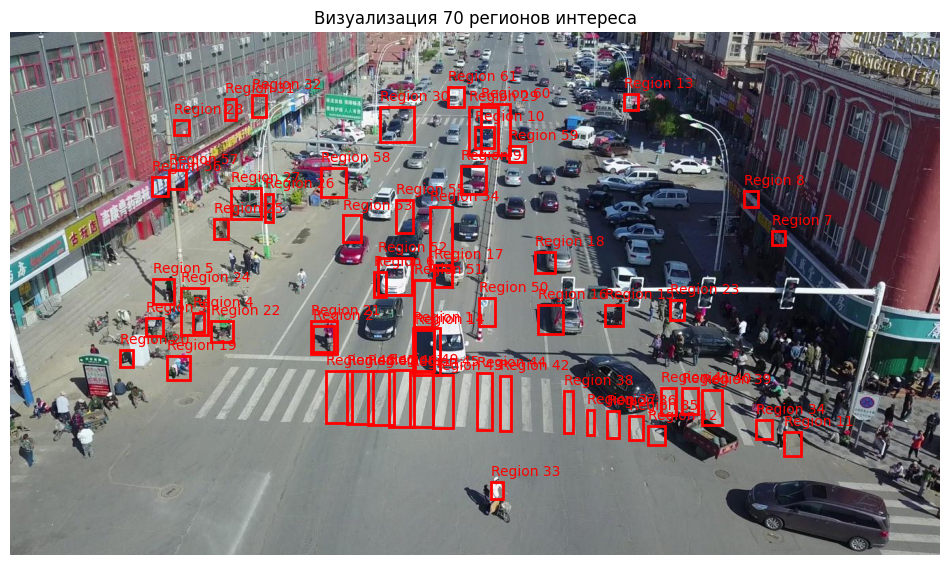

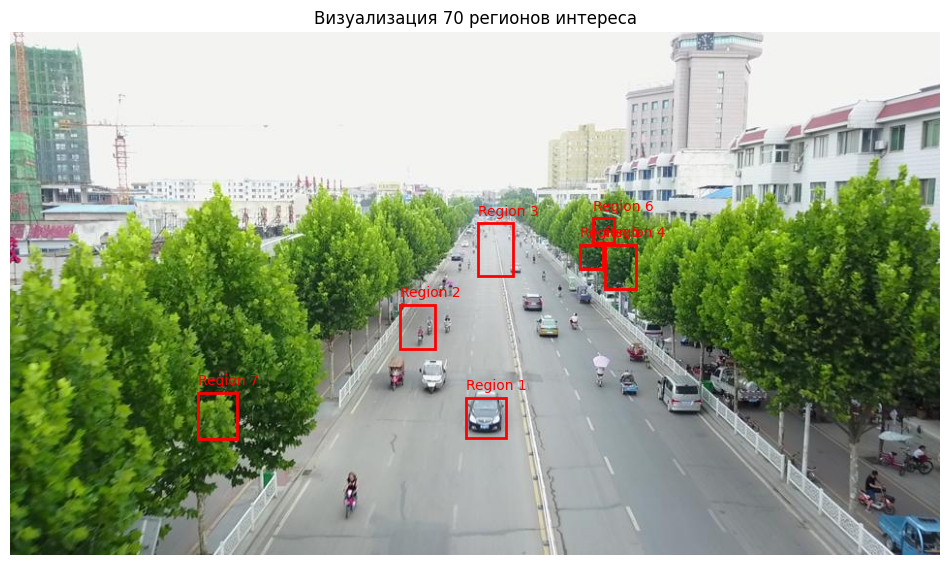

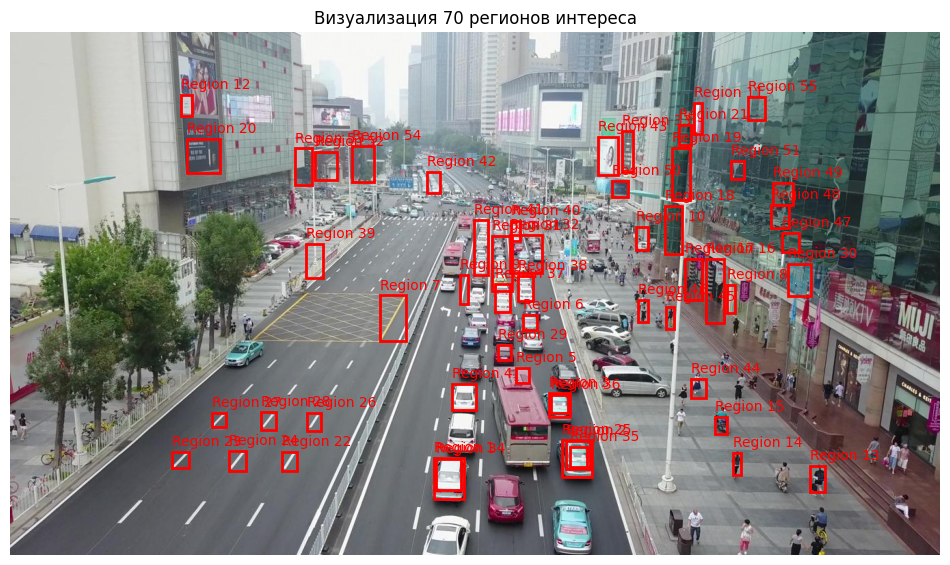

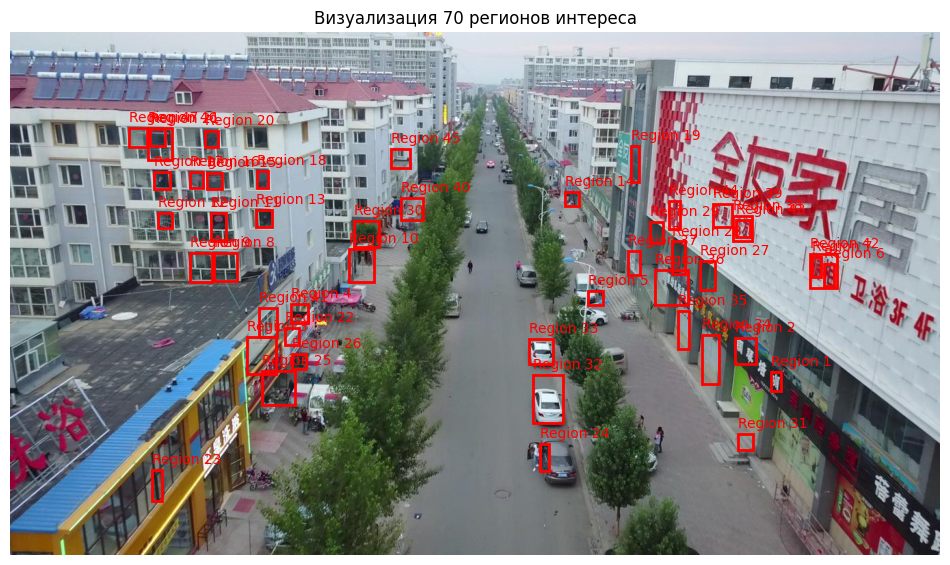

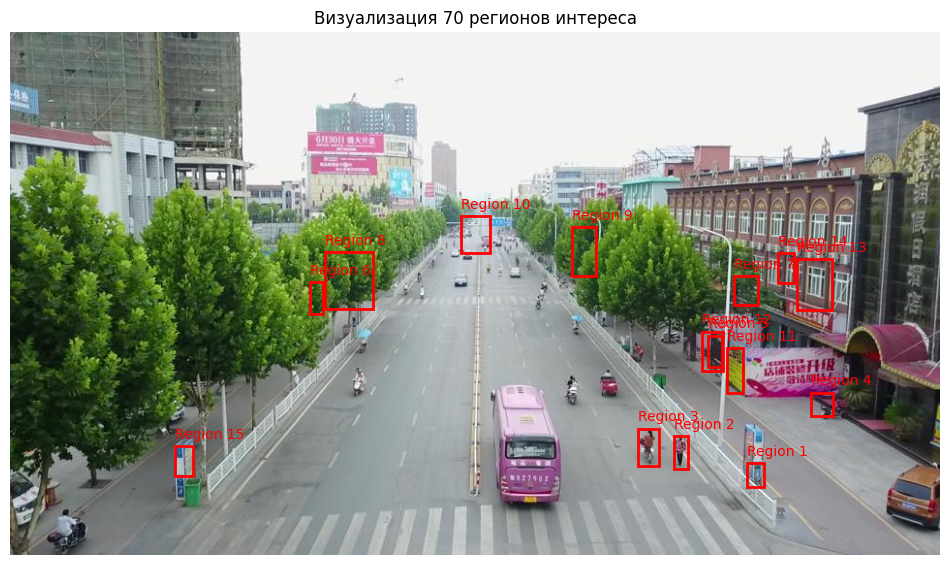

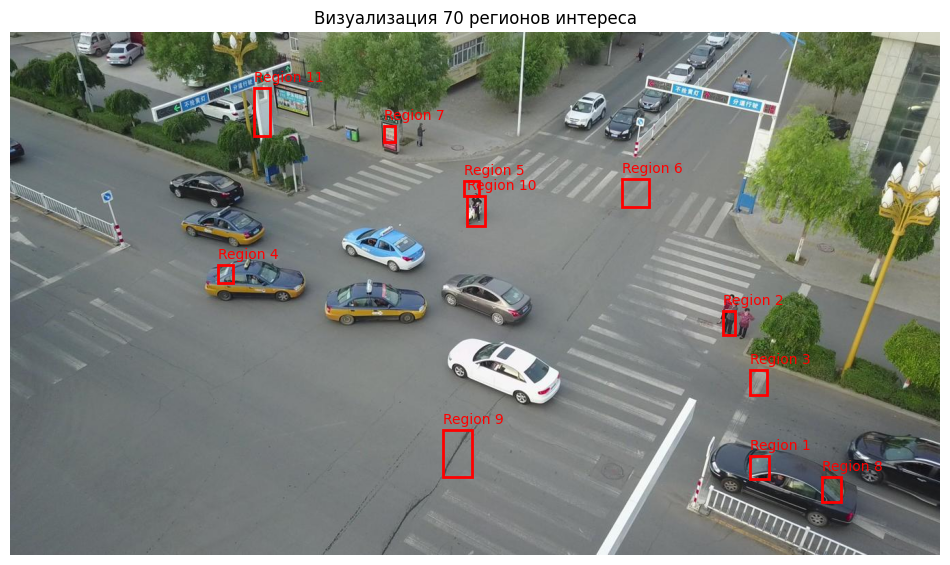

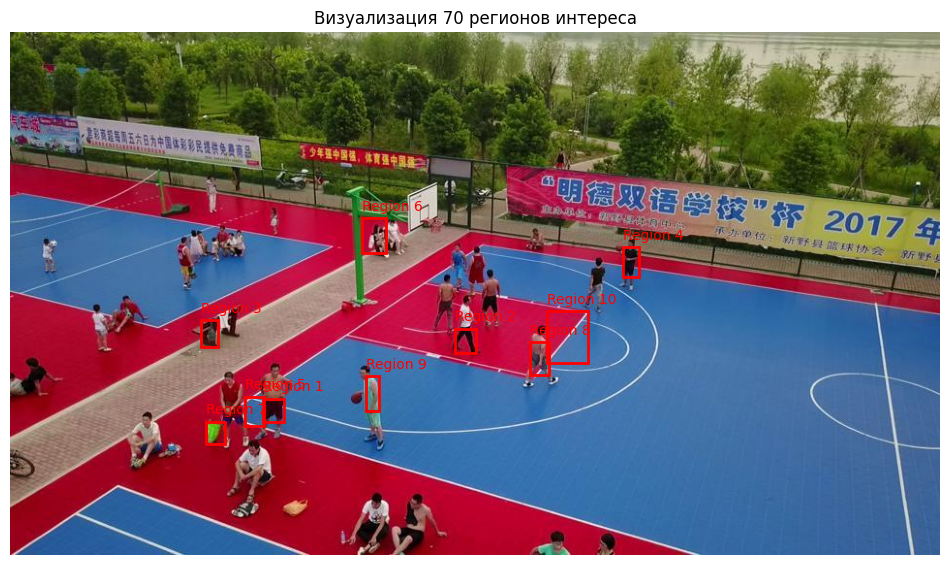

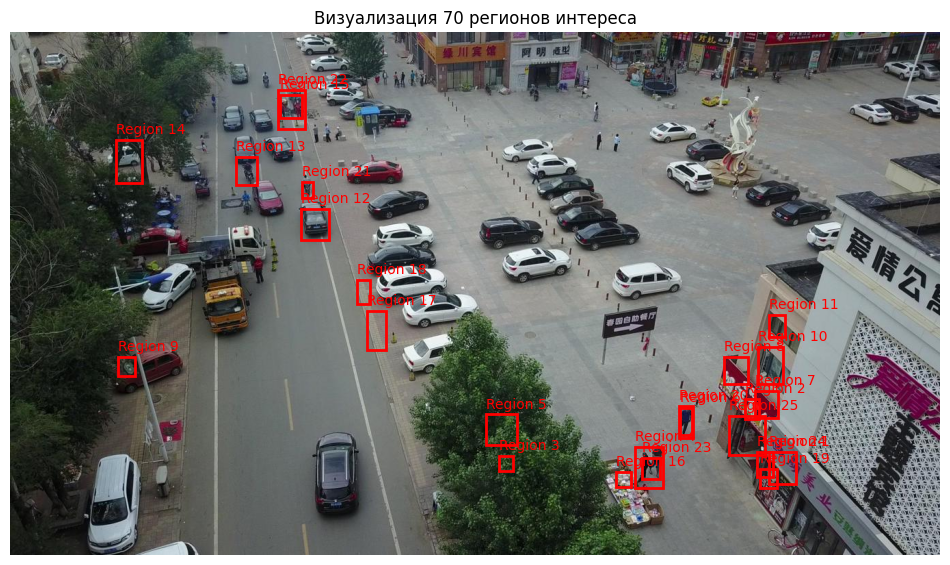

In [12]:
regions_dir = Path("/kaggle/input/regiond-of-interest-best")
# regions_dir = Path('/kaggle/working/output_regions')

for image in valid_images[:10]:
    example_file = regions_dir / f"{image}_regions.pkl"
    image_file = valid_images_dir / f"{image}.jpg"
    
    regions = load_regions_from_file(example_file)
    
    visualize_regions(image_file, regions, num_regions=70)

In [79]:
def process_and_save_regions(regions, target_size=(224, 224), chunk_size=10000):
    num_chunks = int(len(regions) / chunk_size) + 1

    all_indices = []  # Будем работать с индексами, чтобы по ответам можно было вернуть исходных bbox

    for i in range(num_chunks):
        print(f"Обработка части {i + 1}/{num_chunks}")
        start = i * chunk_size
        end = min(start + chunk_size, len(regions))
        current_regions = regions[start:end]

        resized_batch = []
        for idx, region in enumerate(current_regions, start=start):
            resized_patch = resize_with_padding(region, target_size)
            resized_batch.append(resized_patch)
            all_indices.append(idx)

        np.save(f"resnet_regions_chunk_{i}.npy", np.array(resized_batch, dtype=np.uint8))
    
    np.save("region_indices.npy", all_indices)

In [76]:
def load_regions(region_files):
    all_regions = []
    all_coords = []
    all_indices = []

    for file_path in tqdm(region_files):
        image_name = Path(file_path).stem
        regions = joblib.load(file_path)

        for idx, (region, coord) in enumerate(regions):
            all_regions.append(region)
            all_coords.append(coord)
            all_indices.append((image_name, idx))

    return all_regions, all_coords, all_indices

In [77]:
region_files = list(Path("/kaggle/input/regiond-of-interest-best").glob("*.pkl"))
target_size = (224, 224)

In [78]:
regions, coords, names = load_regions(region_files)

100%|██████████| 545/545 [00:01<00:00, 511.14it/s]


In [80]:
process_and_save_regions(regions, target_size=(224, 224), chunk_size=10000)

Обработка части 1/2
Обработка части 2/2


In [81]:
len(regions)

14574

In [82]:
def dataloader_from_regions(regions, batch_size=512):
    tensor_X = torch.tensor(regions, dtype=torch.float32).permute(0, 3, 1, 2) / 255.0
    dataset = TensorDataset(tensor_X)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
    return dataloader

def extract_resnet_features_for_regions(resnet, dataloader, device, region_indices):
    resnet.eval()
    all_features = []
    extracted_indices = []

    with torch.no_grad():
        for batch_idx, images in enumerate(tqdm(dataloader)):
            images = images[0].to(device)
            features = resnet(images)
            all_features.extend(features.cpu().numpy())

            start_idx = batch_idx * dataloader.batch_size
            end_idx = start_idx + len(images)
            extracted_indices.extend(region_indices[start_idx:end_idx])

    return all_features, extracted_indices

In [83]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
resnet = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2).to(device)
resnet.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [84]:
region_indices = np.load("region_indices.npy", allow_pickle=True)
len(region_indices)

14574

In [85]:
batch_size = 512
chunk_size = 5000
num_chunks = 2
output_features = []
all_indices = []
k = 0

for i in range(num_chunks):
    print(f"Загрузка батча {i + 1}/{num_chunks}")

    resized_regions = np.load(f'/kaggle/working/resnet_regions_chunk_{i}.npy', allow_pickle=True)
    num_regions = len(resized_regions)
    
    for j in range((num_regions + chunk_size - 1) // chunk_size):
        start = j * chunk_size
        end = min(start + chunk_size, num_regions)

        current_regions = resized_regions[start:end]
        current_indices = region_indices[start:end]

        dataloader = dataloader_from_regions(current_regions, batch_size=batch_size)
        features, indices = extract_resnet_features_for_regions(resnet, dataloader, device, current_indices)
        
        if len(features) > 0:
            output_features.append(features)
            np.save(f"/kaggle/working/resnet_features_chunk_{k}.npy", features)
            all_indices.extend(indices)

        k += 1

        del current_regions, current_indices, dataloader, features, indices
        torch.cuda.empty_cache()
        gc.collect()

np.save("/kaggle/working/resnet_indices.npy", all_indices)
print(f"Обработка завершена")

Загрузка батча 1/2


100%|██████████| 10/10 [00:09<00:00,  1.10it/s]


Загрузка батча 2/2


100%|██████████| 9/9 [00:08<00:00,  1.08it/s]


Обработка завершена


In [86]:
output_features_combined = np.concatenate(output_features, axis=0)
print(f"Размер массива: {output_features_combined.shape}")

Размер массива: (14574, 1000)


In [87]:
svm = joblib.load("/kaggle/input/svm-pedastrians/svm_trained_model (1).pkl")
print("Модель загружена")

Модель загружена


In [88]:
predictions = svm.predict(output_features_combined)
probas = svm.predict_proba(output_features_combined)

In [89]:
np.save("svm_predictions.npy", predictions)
np.save("svm_probas.npy", probas)

In [90]:
len(predictions)

14574

In [144]:
from matplotlib import pyplot as plt
import matplotlib.patches as patches

def visualize_filtered_regions(image_path, regions, filtered_indices, scores):
    image = cv2.imread(str(image_path))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    fig, ax = plt.subplots(1, figsize=(12, 8))
    ax.imshow(image)
    ax.set_title(f"Визуализация {len(filtered_indices)} целевых регионов")
    
    for i, (region_idx, score) in enumerate(zip(filtered_indices, scores)):
        _, (x, y, w, h) = regions[region_idx]
        rect = plt.Rectangle((x, y), w, h, edgecolor='g', facecolor='none', linewidth=2)
        ax.add_patch(rect)
        ax.text(
            x, y - 5, f"Score: {score:.2f}", color='green',
            fontsize=10, va='bottom', ha='left'
        )

    plt.axis("off")
    plt.show()

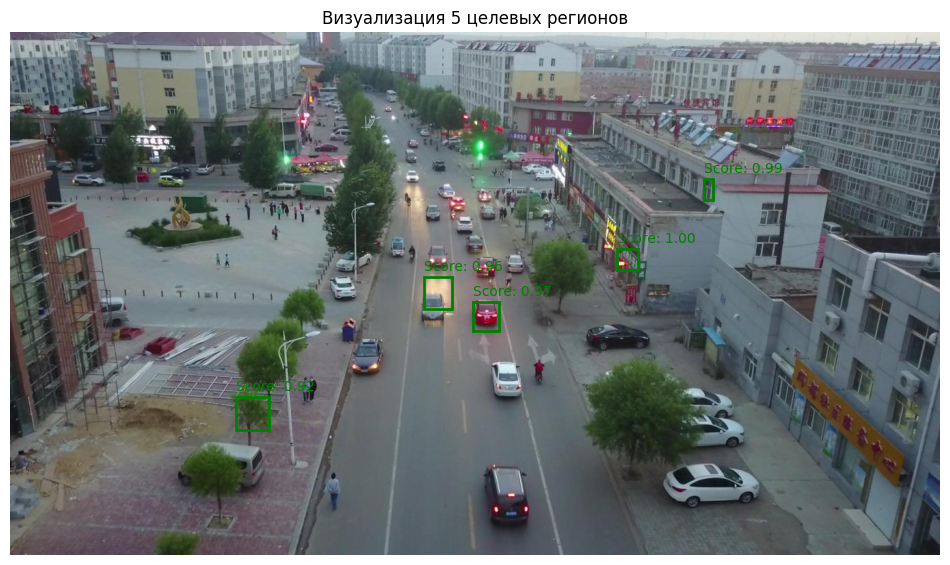

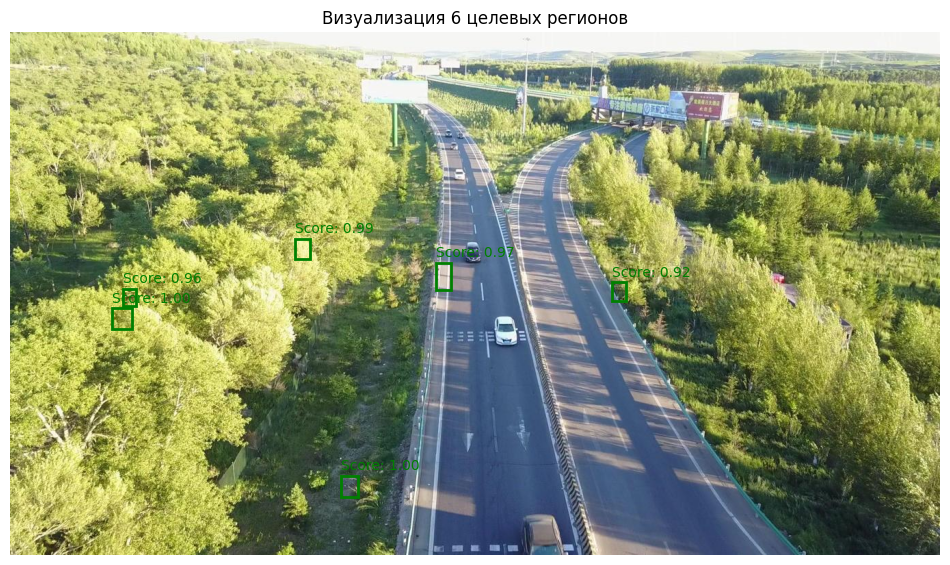

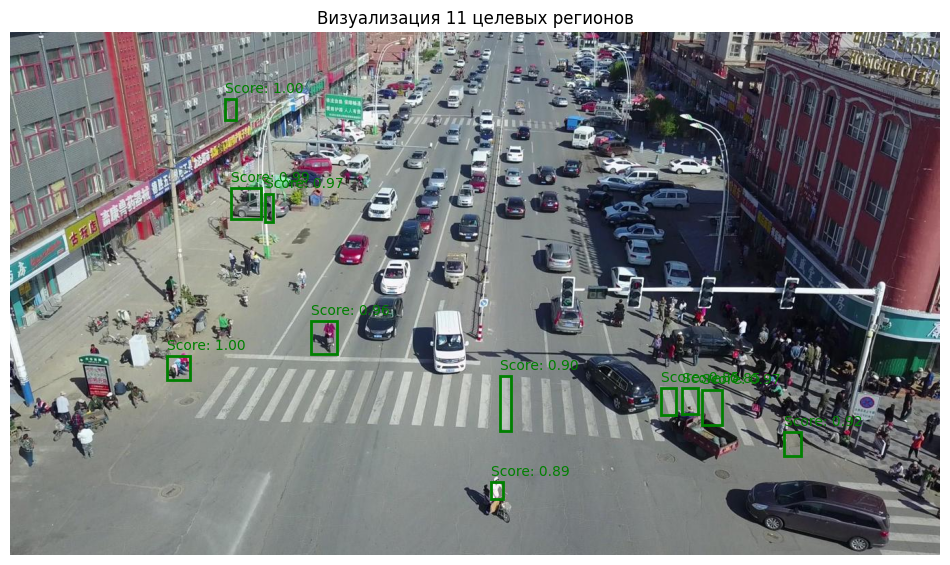

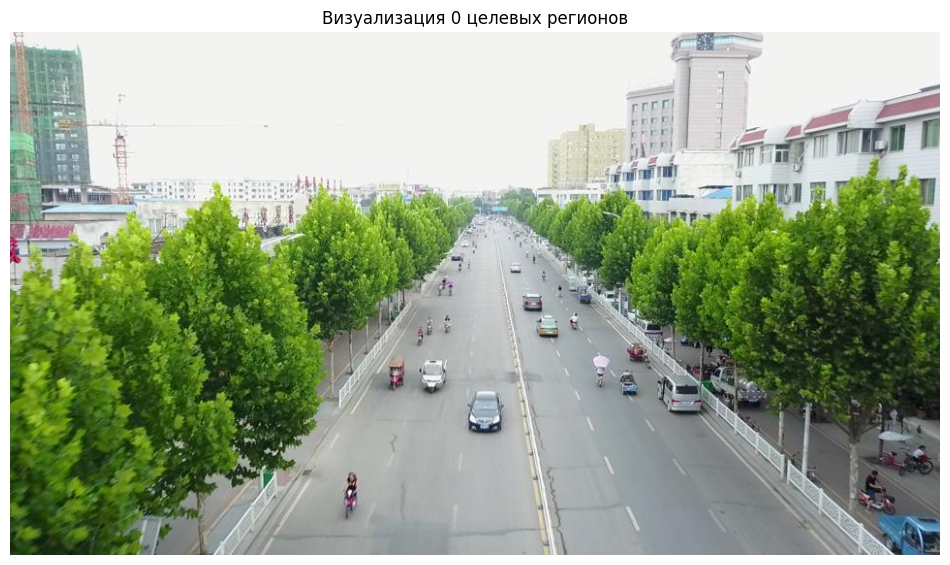

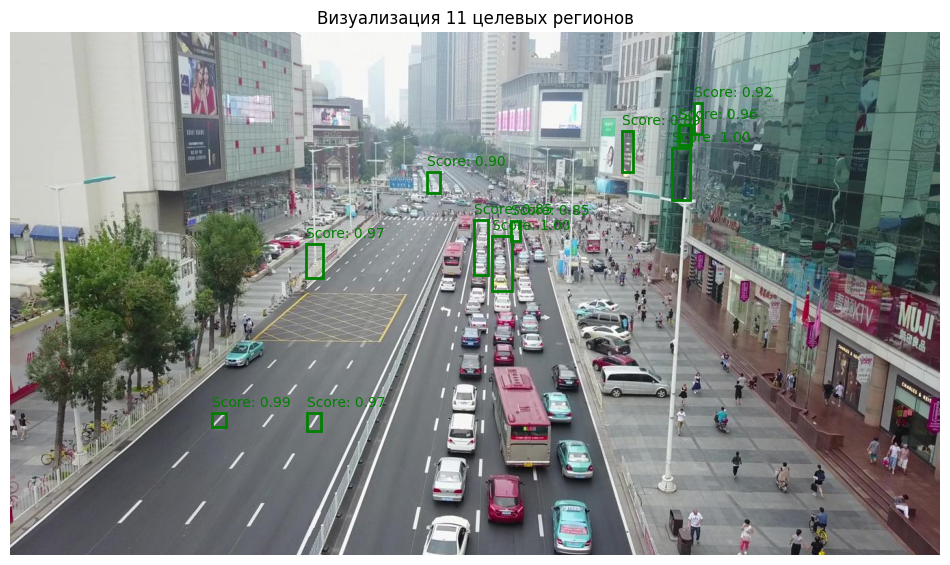

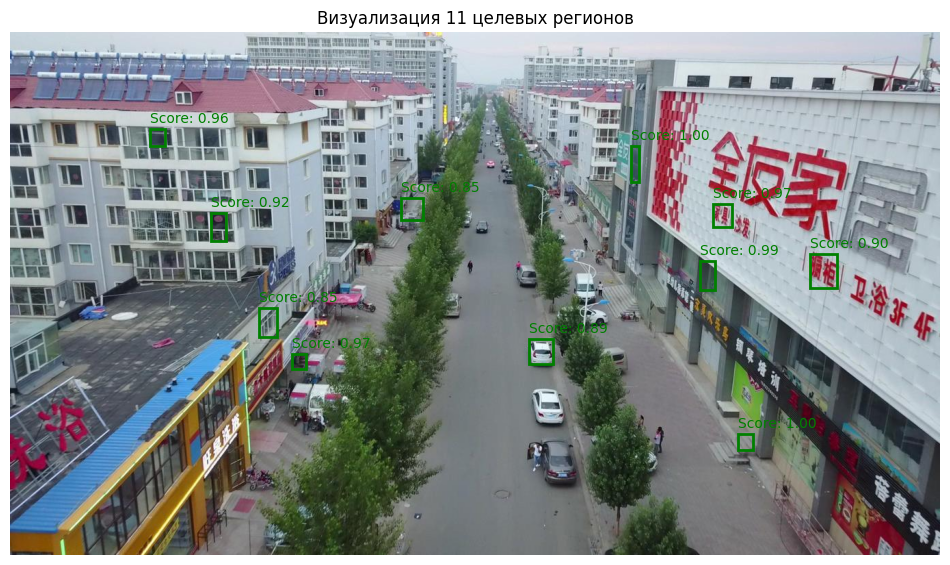

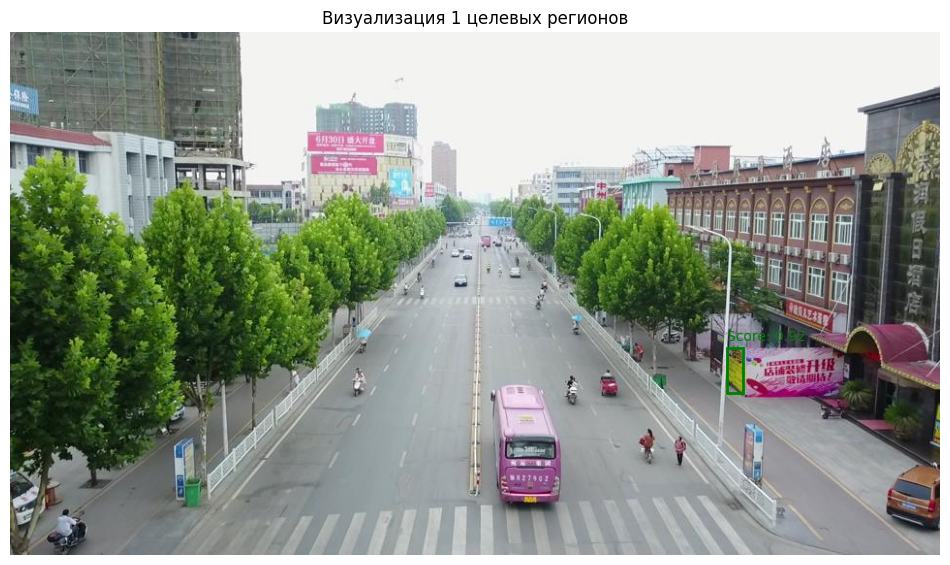

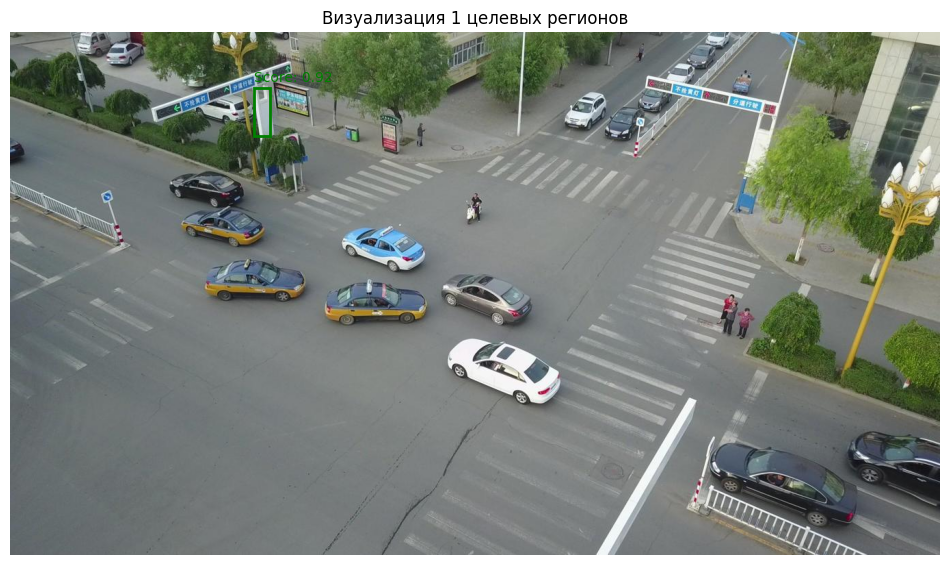

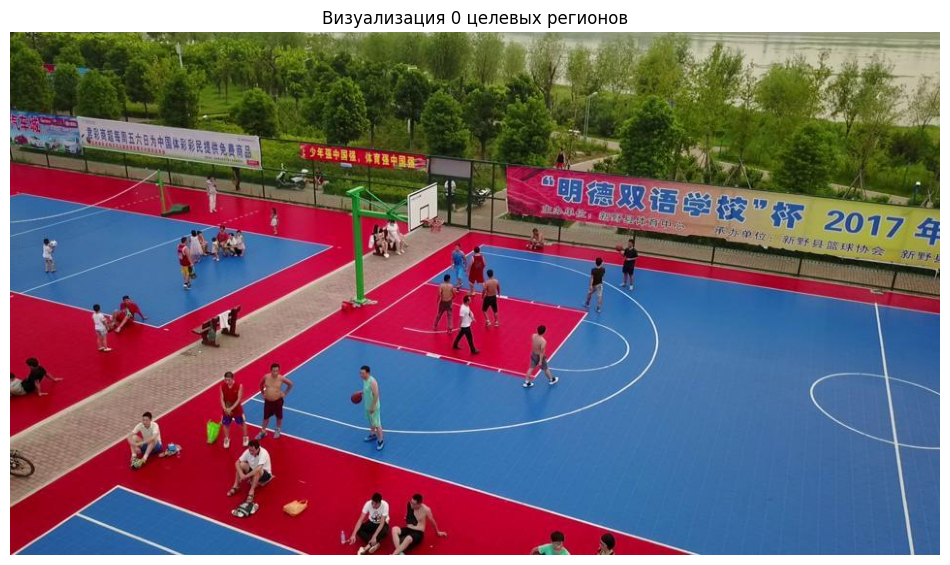

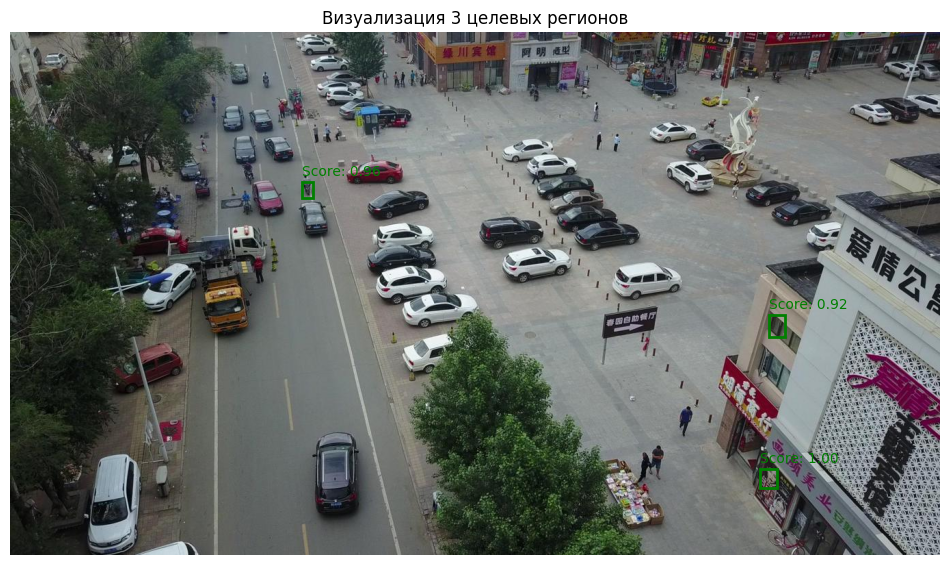

In [165]:
threshold = 0.85

filtered_indices = [
    idx for resnet_idx, idx in enumerate(region_indices)
    if predictions[resnet_idx] == 1 and probas[resnet_idx][1] >= threshold
]

for i in range(10):
    image_name = valid_images[i]
    image_path = valid_images_dir / f"{image_name}.jpg"

    regions_path = f'/kaggle/input/regiond-of-interest-best/{image_name}_regions.pkl'
    original_regions = joblib.load(regions_path)

    current_filtered_indices = []
    current_scores = []

    for idx, (name, region_idx) in enumerate(names):
        if name.replace('_regions', '') == image_name and region_idx in filtered_indices:
            match_idx = np.where(region_indices == region_idx)[0]
            if len(match_idx) > 0:
                score = probas[match_idx[0]][1]
                current_filtered_indices.append(region_idx)
                current_scores.append(score)

    visualize_filtered_regions(image_path, original_regions, current_filtered_indices, current_scores)

## Metrics
Считаем IoU для нашей реализации с моделью и для бибокса среднего размера (16 на 30 пикселей), вырезанного из центра

### Сохранение предсказанных bboxes

In [192]:
# folder_path = dataset_dir/"valid/predicted_labels"
# 
# if os.path.exists(folder_path):
#      # Удаляем все содержимое
#      shutil.rmtree(folder_path)
#      print(f"Папка {folder_path} очищена.")

Папка data/Aerial-Person-Detection-3/valid/predicted_labels очищена.


In [193]:
labels_pred = Path(dataset_dir/"valid/predicted_labels")
labels_pred.mkdir(parents=True, exist_ok=True)

In [194]:
def convert_to_yolo(coords, img_w, img_h):
    x_min, y_min, width, height = coords
    x_center = (x_min + width / 2) / img_w
    y_center = (y_min + height / 2) / img_h
    norm_width = width / img_w
    norm_height = height / img_h
    
    return (x_center, y_center, norm_width, norm_height)

In [195]:
def save_predicted_bboxes(image_name, names, coords, predicted_indices, image_dir, output_dir, class_id=1):
    image_path = os.path.join(image_dir, f"{image_name}.jpg")
    image = cv2.imread(image_path)
    img_h, img_w = image.shape[:2]
    
    predicted_boxes = []

    for idx in predicted_indices:
        region_image_name, region_idx = names[idx]
        
        if region_image_name.replace('_regions', '') == image_name:
            yolo_box = convert_to_yolo(coords[idx], img_w, img_h)
            predicted_boxes.append(yolo_box)

    file_name = f"{image_name}.txt"
    file_path = os.path.join(output_dir, file_name)

    with open(file_path, "w") as f:
        for x_center, y_center, width, height in predicted_boxes:
            f.write(f"{class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")

In [196]:
filtered_indices = [
    idx for resnet_idx, idx in enumerate(region_indices)
    if predictions[resnet_idx] == 1 and probas[resnet_idx][1] >= threshold
]

filtered_indices[:2]

[10, 18]

In [197]:
for image_name in valid_images:
    save_predicted_bboxes(
        image_name=image_name,
        names=names,
        coords=coords,
        predicted_indices=filtered_indices,
        image_dir=valid_images_dir,
        output_dir=labels_pred
    )

### Intersection over Union

In [205]:
def load_yolo_boxes(file_path, target_class=1):
    boxes = []
    if not os.path.exists(file_path):
        print(f"Файл {file_path} не найден.")
        return boxes

    with open(file_path, "r") as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) == 5:
                class_id, x_center, y_center, width, height = map(float, parts)
                if int(class_id) == target_class:
                    boxes.append((x_center, y_center, width, height))
    
    return boxes

In [212]:
def evaluate_model_iou(predicted_dir, real_dir, image_list, iou_threshold=0.5):
    iou_scores = []

    for image_name in image_list:
        predicted_file = os.path.join(predicted_dir, f"{image_name}.txt")
        real_file = os.path.join(real_dir, f"{image_name}.txt")

        predicted_boxes = load_yolo_boxes(predicted_file)
        real_boxes = load_yolo_boxes(real_file, target_class=4)  # Фильтруем только людей

        for pred_box in predicted_boxes:
            best_iou = 0
            for real_box in real_boxes:
                iou = calculate_iou(pred_box, real_box)
                best_iou = max(best_iou, iou)

            iou_scores.append(best_iou)

    mean_iou = np.mean(iou_scores)
    accuracy = np.mean([iou >= iou_threshold for iou in iou_scores])
    
    return mean_iou, accuracy

In [213]:
mean_iou, accuracy = evaluate_model_iou(labels_pred, valid_labels_dir, valid_images)

print(f"Среднее значение IoU: {mean_iou:.4f}")
print(f"Точность предсказаний при пороге 0.5: {accuracy:.4f}")

Среднее значение IoU: 0.1402
Точность предсказаний при пороге 0.5: 0.1212


In [214]:
def get_center_bbox(img_width, img_height, bbox_width=16, bbox_height=30):
    x_center = img_width / 2
    y_center = img_height / 2

    x_center_norm = x_center / img_width
    y_center_norm = y_center / img_height
    width_norm = bbox_width / img_width
    height_norm = bbox_height / img_height

    return (x_center_norm, y_center_norm, width_norm, height_norm)

In [215]:
def evaluate_center_bbox_iou(real_dir, image_list, image_dir, bbox_size=(16, 30), target_class=4, iou_threshold=0.5):
    iou_scores = []

    for image_name in image_list:
        image_path = os.path.join(image_dir, f"{image_name}.jpg")
        image = cv2.imread(image_path)
        img_h, img_w = image.shape[:2]

        center_bbox = get_center_bbox(img_w, img_h, *bbox_size)

        real_file = os.path.join(real_dir, f"{image_name}.txt")
        real_boxes = load_yolo_boxes(real_file, target_class=target_class)

        for real_box in real_boxes:
            iou = calculate_iou(center_bbox, real_box)
            iou_scores.append(iou)

    mean_iou = np.mean(iou_scores)
    accuracy = np.mean([iou >= iou_threshold for iou in iou_scores])

    return mean_iou, accuracy

In [217]:
center_mean_iou, center_accuracy = evaluate_center_bbox_iou(
    real_dir=valid_labels_dir,
    image_list=valid_images,
    image_dir=valid_images_dir,
    bbox_size=(16, 30)
)

print(f"Среднее значение IoU для центрального бокса: {center_mean_iou:.4f}")
print(f"Точность при пороге 0.5: {center_accuracy:.4f}")

Среднее значение IoU для центрального бокса: 0.0006
Точность при пороге 0.5: 0.0001
